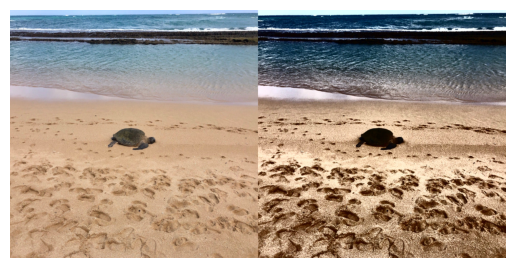

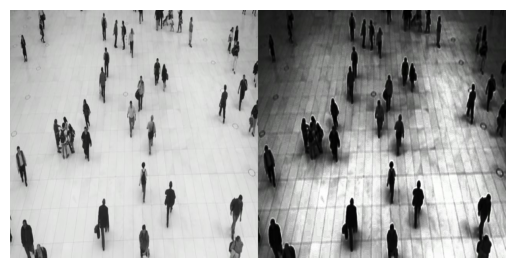

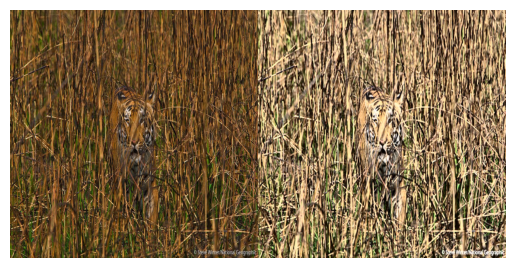

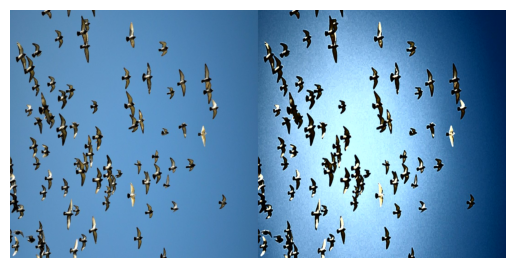

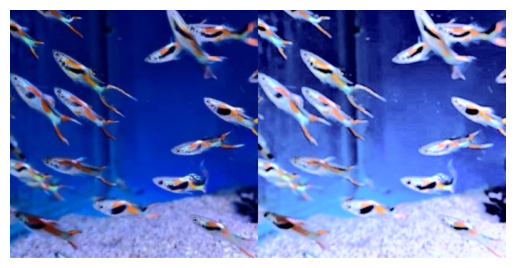

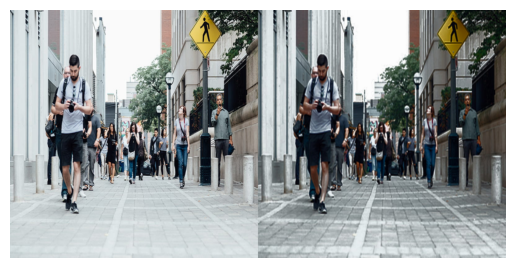

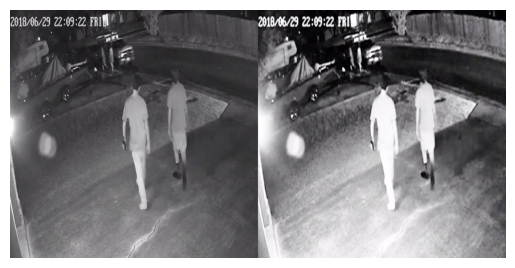

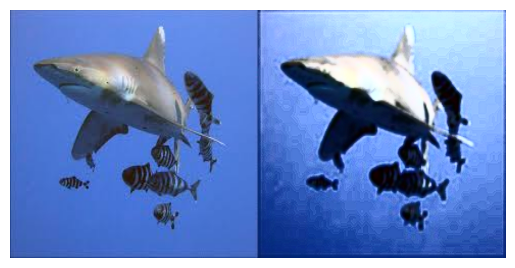

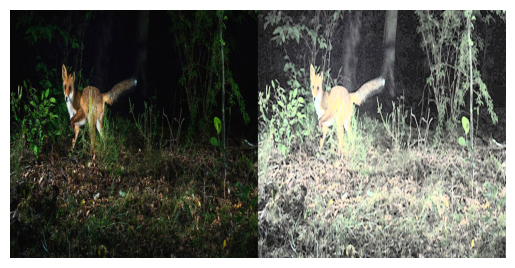

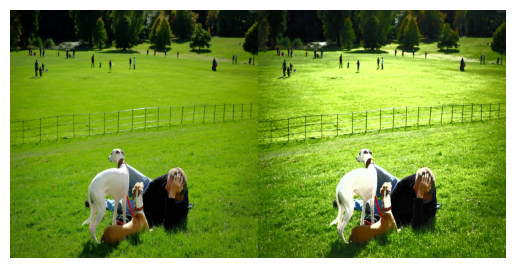

In [ ]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt

#https://docs.google.com/document/d/1gQLO6Oqdu946d8UxUrOiLerWwPb5aIcxf1LLheFv_Vc/edit?tab=t.0 - Recorte
#https://docs.google.com/document/d/1gci9PsEcC1jS_--6-EOZHHS0kuyW3mqSovVdQ3AffcM/edit?tab=t.0#heading=h.pgb897q60pw - Filtros, histrograma, etc

caminho = glob.glob('imagens/*.jpg')[:10]
imagens = [cv2.imread(p) for p in caminho]

def processar_imagens(img, novo_tamanho=(512,512)):
    
    
    img_blur = cv2.GaussianBlur(img, (5,5), sigmaX=1.5)
    
    #kernel pro sharpen
    kernel = np.array([[0, -1, 0],
                       [-1, 5, -1],
                       [0, -1, 0]])
    
    imagem_sharpened = cv2.filter2D(img_blur, -1, kernel)
    
    # Convert to YCrCb e equaliza canal Y
    ycrcb = cv2.cvtColor(imagem_sharpened, cv2.COLOR_BGR2YCrCb)
    ycrcb[:,:,0] = cv2.equalizeHist(ycrcb[:,:,0])
    eq = cv2.cvtColor(ycrcb, cv2.COLOR_YCrCb2BGR)
    
    #redimensiona
    img_redimensionada = cv2.resize(eq, novo_tamanho, interpolation=cv2.INTER_AREA)
    return img_redimensionada

imagens_processadas = [processar_imagens(img) for img in imagens]

for orig, proc in zip(imagens, imagens_processadas):

    orig_resized = cv2.resize(orig, (512,512), interpolation=cv2.INTER_AREA)
    # Concatena horizontalmente original e processada
    imagens_combinadas = np.hstack((orig_resized, proc))
    plt.figure()
    plt.imshow(cv2.cvtColor(imagens_combinadas, cv2.COLOR_BGR2RGB))
    plt.axis('off')
plt.show()

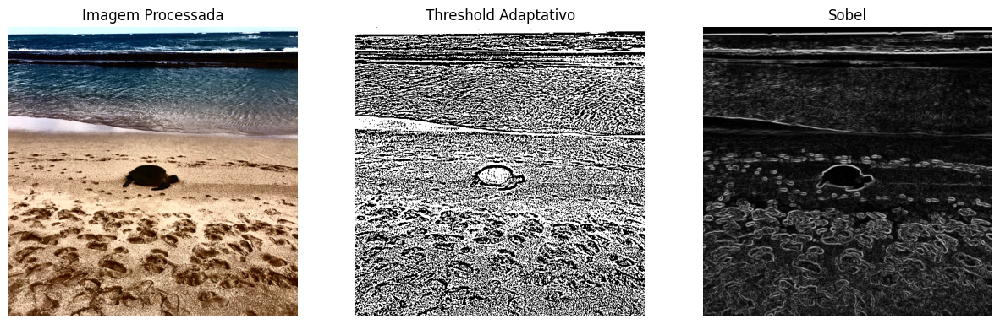

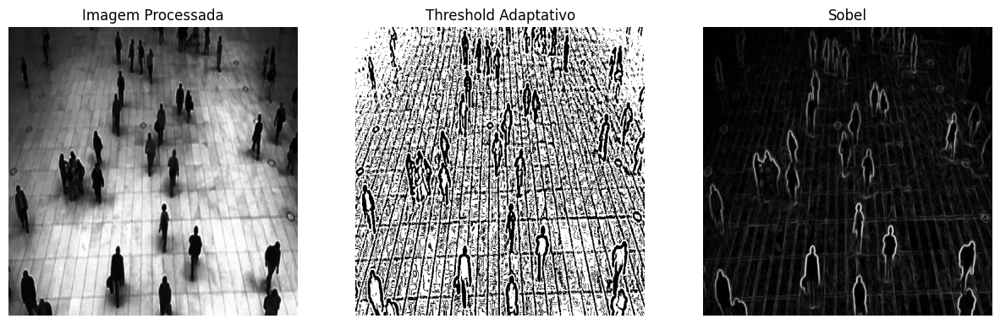

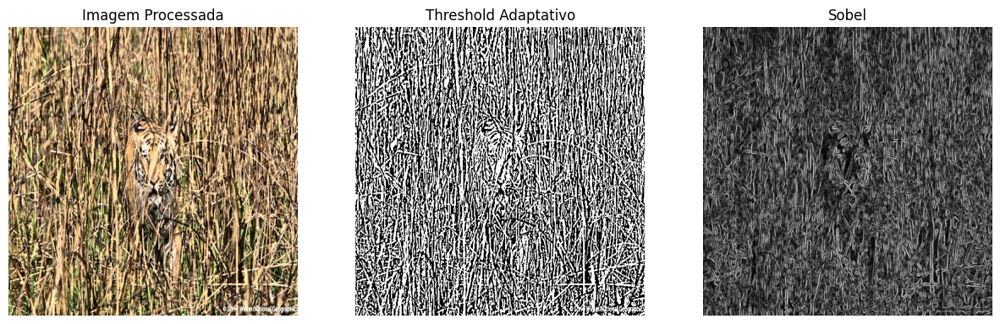

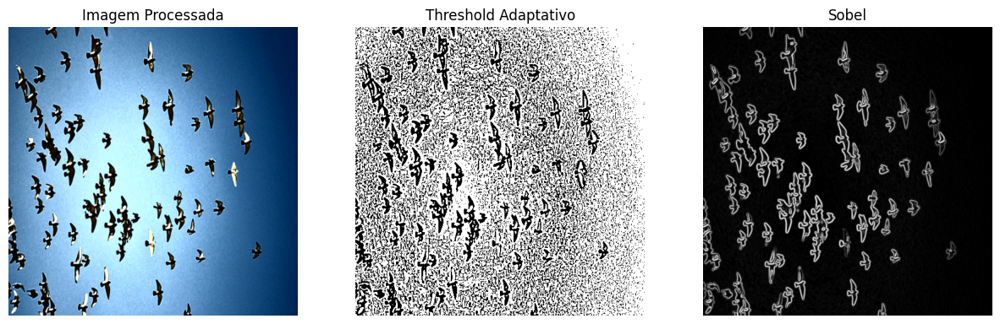

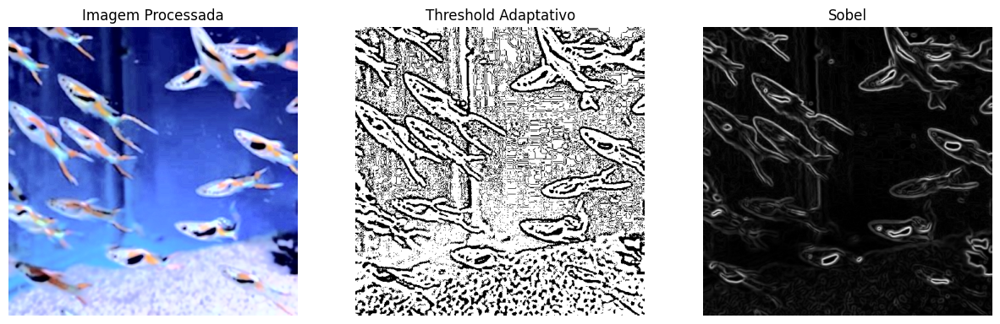

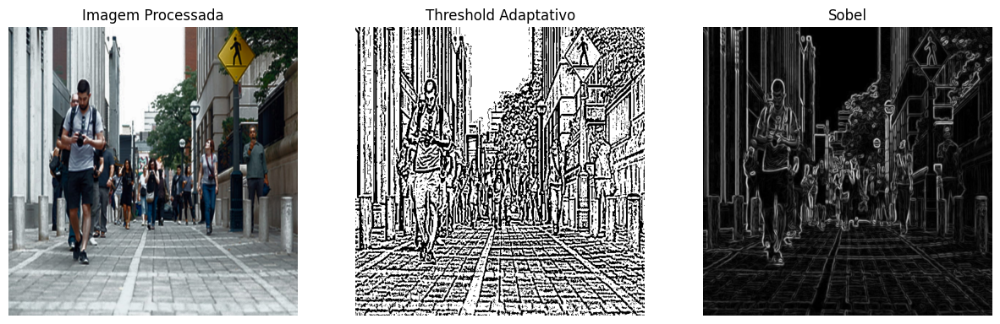

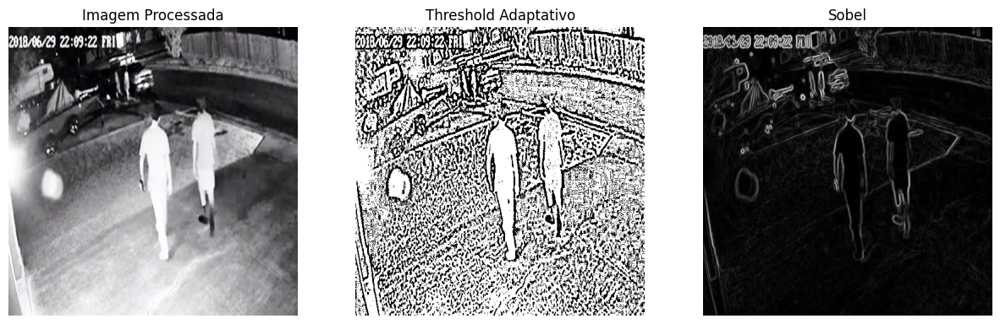

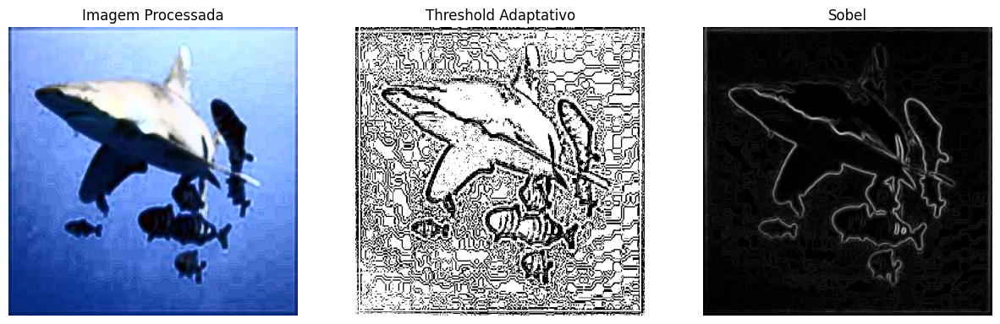

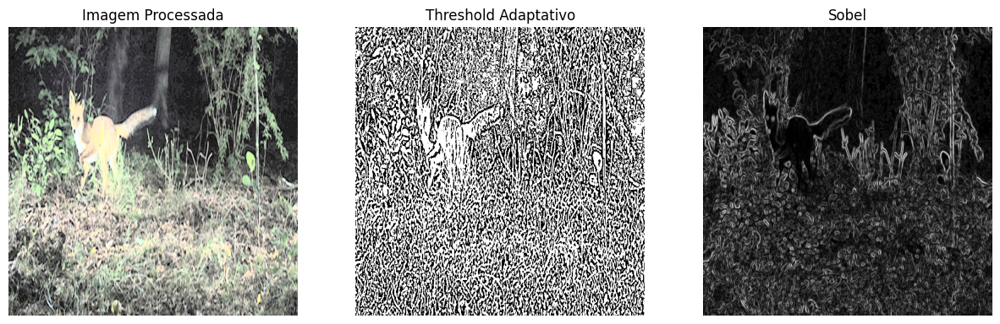

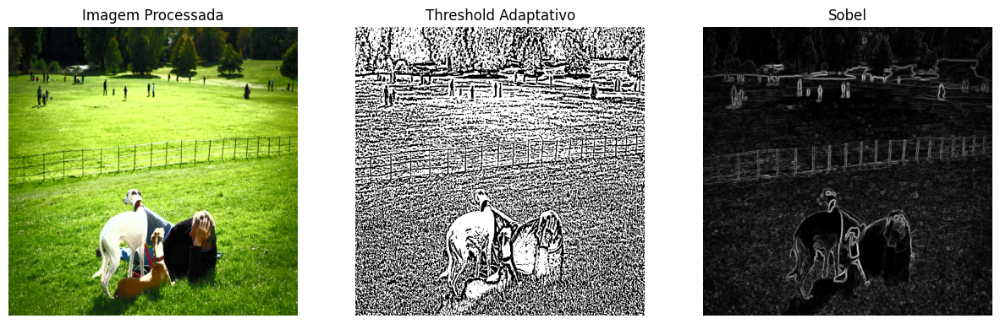

In [2]:
for orig, proc in zip(imagens, imagens_processadas):

    proc_gray = cv2.cvtColor(proc, cv2.COLOR_BGR2GRAY)
    
    #https://docs.google.com/document/d/1gQLO6Oqdu946d8UxUrOiLerWwPb5aIcxf1LLheFv_Vc/edit?tab=t.0
    imagem_adaptativa = cv2.adaptiveThreshold(proc_gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                              cv2.THRESH_BINARY, 11, 2)
    
    # Utilizamos Sobel pois ele é um algorítimo mais rápido comparado ao canny e tambem nao polui imagens que possuem-
    # muitos detalhes
    #https://docs.google.com/document/d/1FVrFHxNbEwMUu1-66BUFR-F4C6gjMVomAVYY4ZPmUUQ/edit?tab=t.0#heading=h.1kwg48g5mal5 - Sobel, prewitt, canny..
    sobelx = cv2.Sobel(proc_gray, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(proc_gray, cv2.CV_64F, 0, 1, ksize=5)
    sobel = cv2.magnitude(sobelx, sobely)
    sobel = np.uint8(255 * sobel / np.max(sobel))
    
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(proc, cv2.COLOR_BGR2RGB))
    plt.title('Imagem Processada')
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.imshow(imagem_adaptativa, cmap='gray')
    plt.title('Threshold Adaptativo')
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.imshow(sobel, cmap='gray')
    plt.title('Sobel')
    plt.axis('off')
    
plt.show()

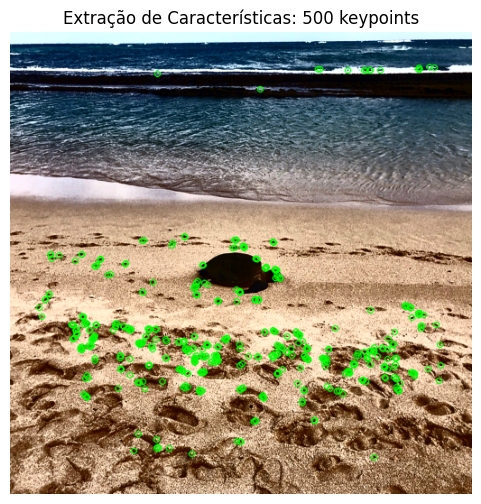

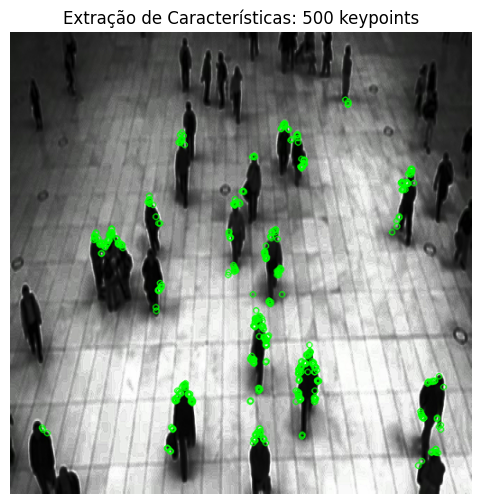

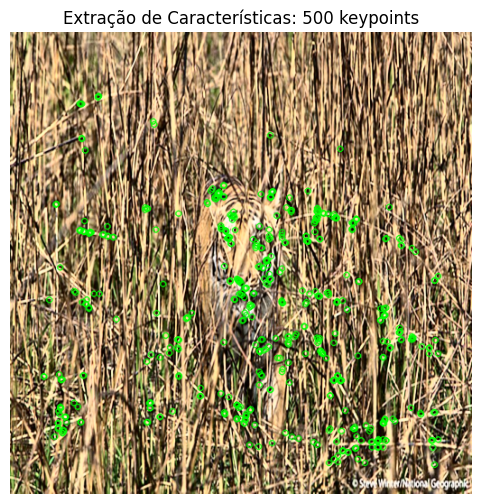

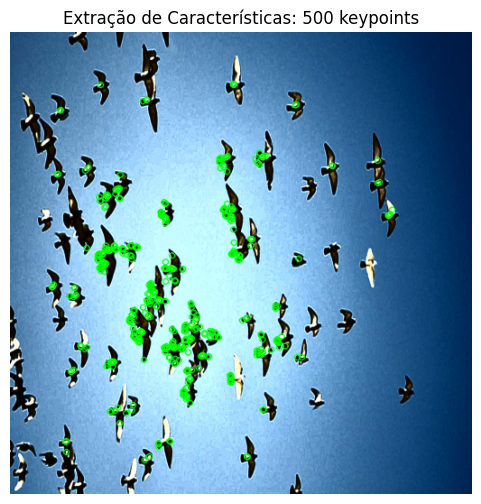

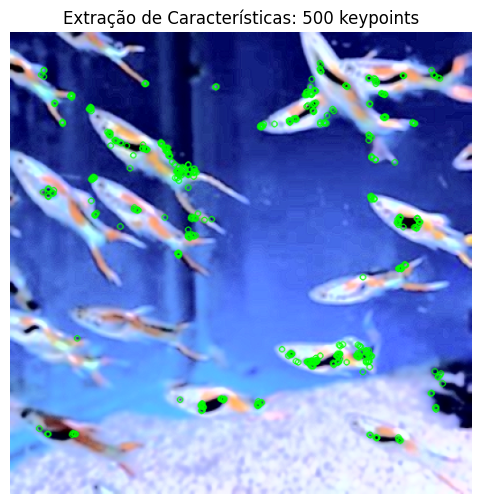

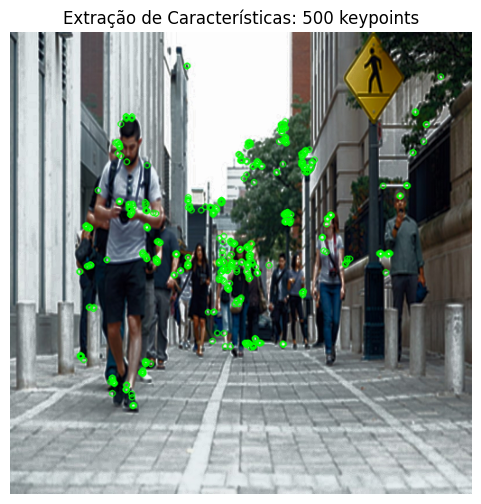

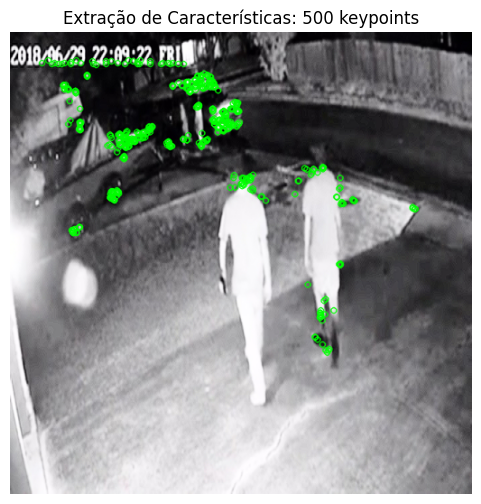

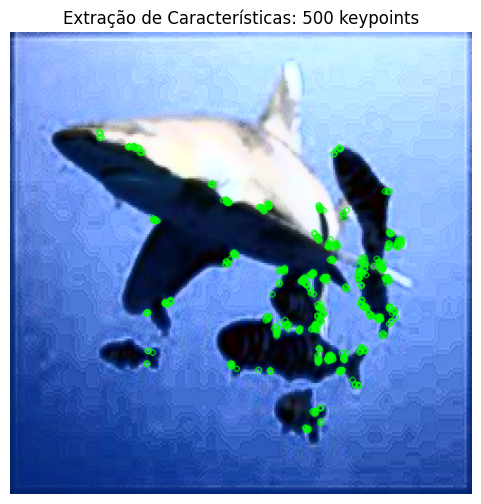

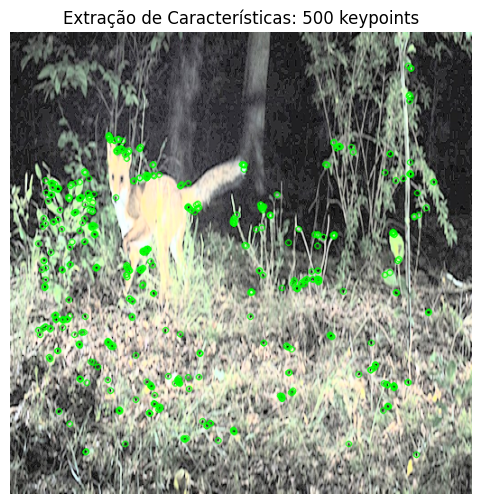

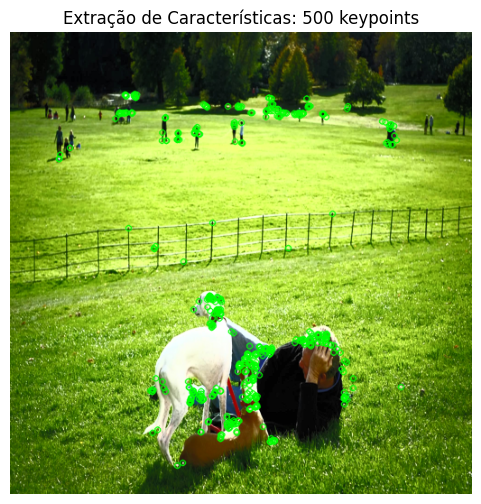

In [3]:
#https://docs.google.com/document/d/12rqF-CXDxADg43MtCsVRS6kkeO5zXlaxz5pPMvuUQs4/edit?tab=t.0#heading=h.w9m0b72nf1q9 - SIFT e ORB
orb = cv2.ORB_create()

for proc in imagens_processadas:
    #precisa converter a imagem em escala de cinza
    proc_gray = cv2.cvtColor(proc, cv2.COLOR_BGR2GRAY)
    
    keypoints, descriptors = orb.detectAndCompute(proc_gray, None)
    
    #pontos chave na imagem
    img_keypoints = cv2.drawKeypoints(proc, keypoints, None, color=(0,255,0), flags=0)
    
    plt.figure(figsize=(6,6))
    plt.imshow(cv2.cvtColor(img_keypoints, cv2.COLOR_BGR2RGB))
    plt.title(f"Extração de Características: {len(keypoints)} keypoints")
    plt.axis('off')
    
plt.show()

# Pensar mais tarde, como as caracteristicas extraidas podem ser usados para comparar ou classificar imagens?

# Os descritores obtidos (variável 'descriptors') podem ser usados para comparar ou classificar imagens,
# por exemplo, através de algoritmos de matching (FLANN, BFMatcher) ou em métodos de aprendizado de máquina.

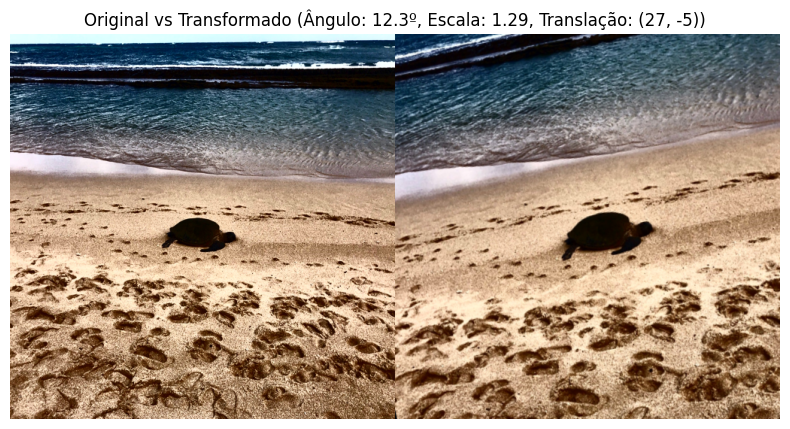

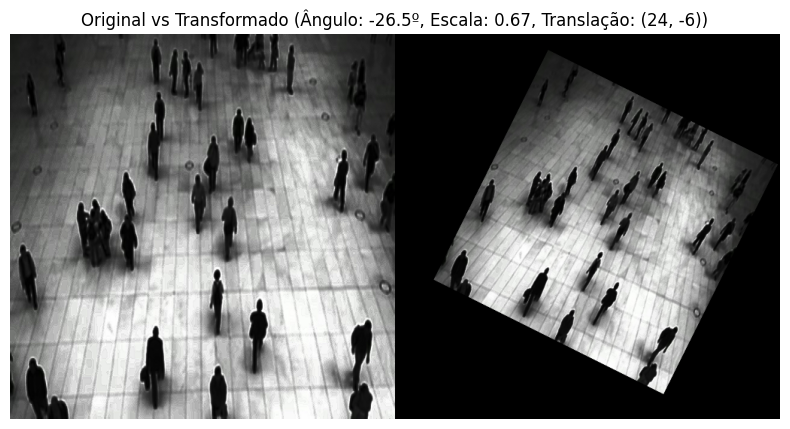

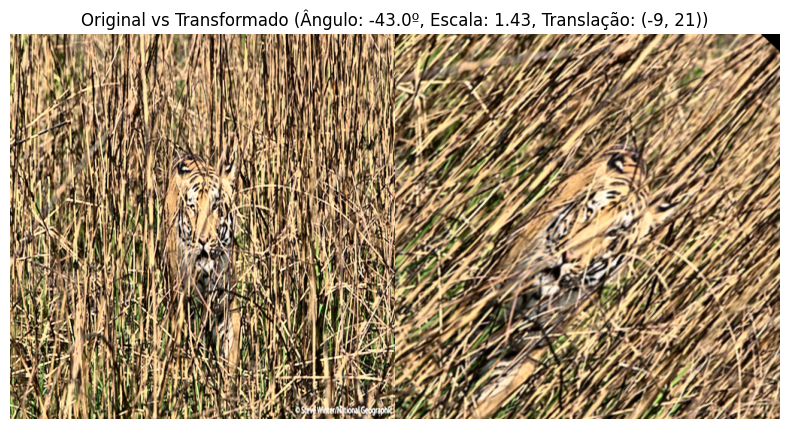

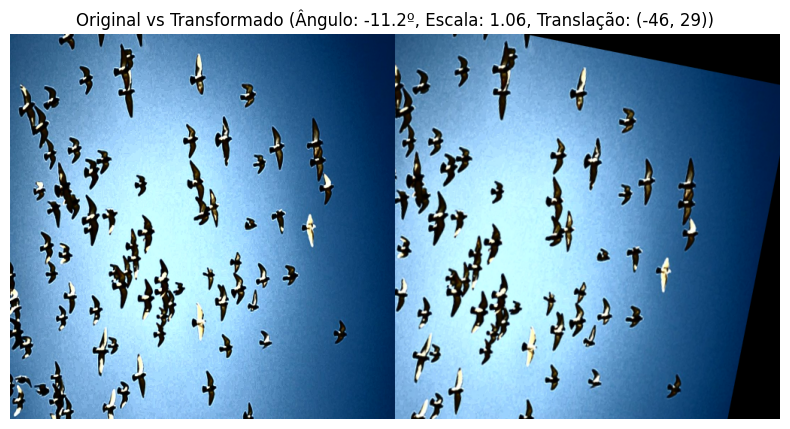

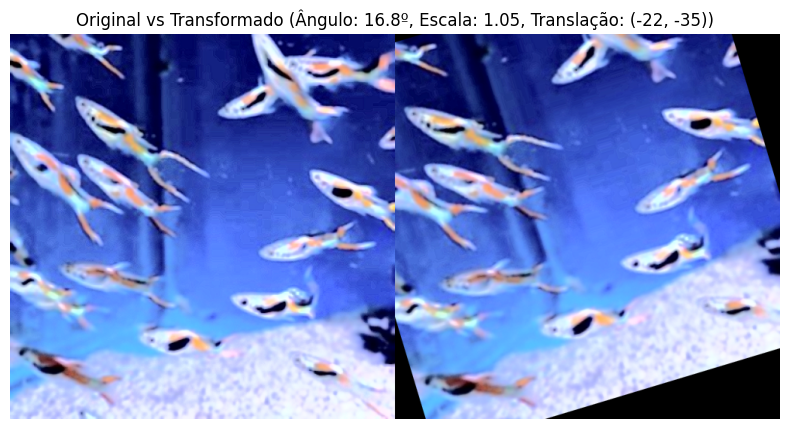

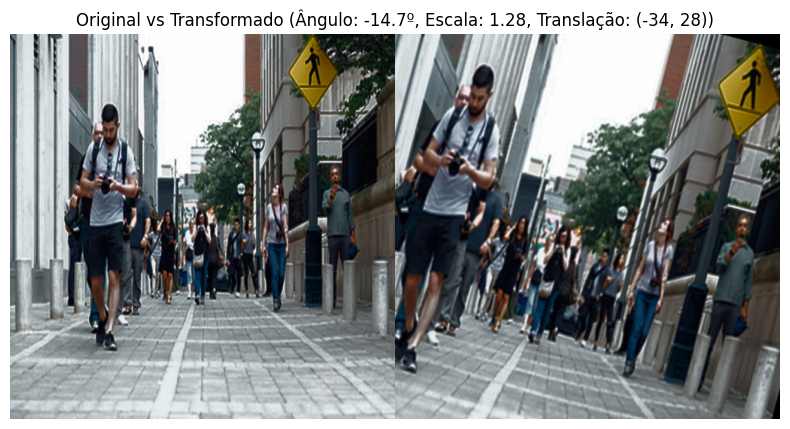

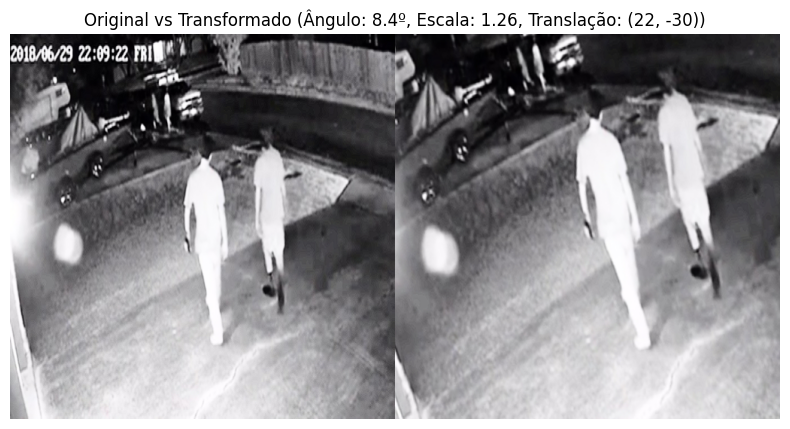

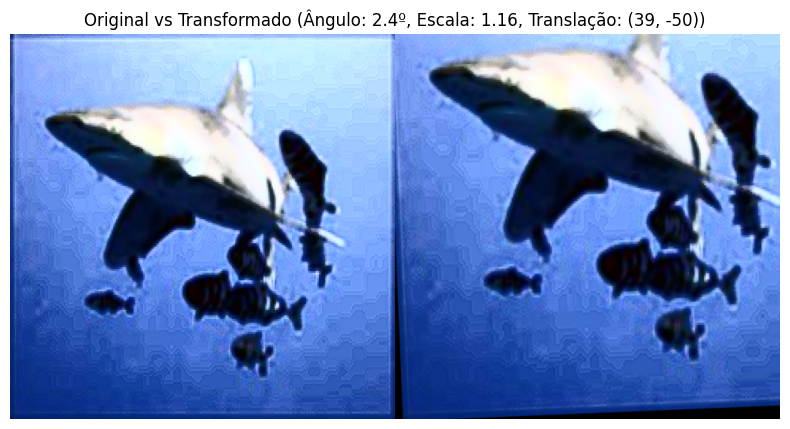

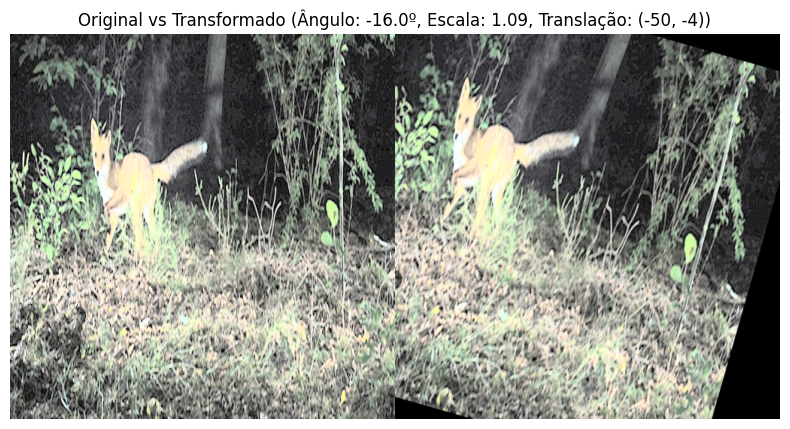

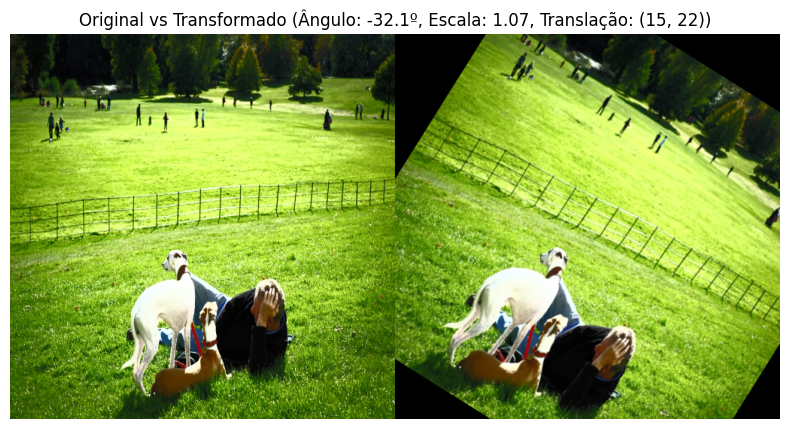

In [ ]:
#https://docs.google.com/document/d/1rGOf4__9KqL1c6qpCddTv7Wlt37Ul-QMxCDv5Gt30h0/edit?tab=t.0#heading=h.wsrhulpql4xx - Transformacao, rotacao, etc

import random

for img in imagens_processadas:
    h, w = img.shape[:2]
    
    # parametros aleatorios
    angle = random.uniform(-45, 45)          # rotação entre -45 e 45 graus
    scale = random.uniform(0.5, 1.5)           # escala entre 0.5 e 1.5
    tx = random.randint(-50, 50)               # Translação horizontal aleatória
    ty = random.randint(-50, 50)               # Translação vertical aleatória
    
    # Criação da matriz de transformação: rotação + escala
    M = cv2.getRotationMatrix2D((w/2, h/2), angle, scale)
    # Adicionar translação à matriz
    M[0, 2] += tx
    M[1, 2] += ty
    
    # Aplicação da transformação
    transformed = cv2.warpAffine(img, M, (w, h))
    
    # Exibição lado a lado: imagem original vs transformada
    combined = np.hstack((img, transformed))
    plt.figure(figsize=(10, 5))
    plt.imshow(cv2.cvtColor(combined, cv2.COLOR_BGR2RGB))
    plt.title(f"Original vs Transformado (Ângulo: {angle:.1f}º, Escala: {scale:.2f}, Translação: ({tx}, {ty}))")
    plt.axis('off')

plt.show()